# Visualización de Información en Python


> **Autor** \
> Eduardo Graells-Garrido \
> Instituto de Data Science UDD \
> Telefónica I+D Chile \
> egraells@udd.cl \
> @carnby

## Sesión 4: Introducción a la Visualización de Redes

> **Caso de Estudio** \
> Data Set: Jazz Network \
> Diplomado en Data Science UDD

## Introducción

En este notebook haremos una pausa respecto al data set a trabajar.

Aprenderemos a visualizar redes con [NetworkX](http://networkx.github.io/), la biblioteca para trabajar con redes más común en Python.

Los propósitos de esta clase son los siguientes:

  1. Cargar una red.
  2. Explorar como NetworkX permite visualizarla.
  3. Definir una tarea y usar visualización para responderla.
  
### Requerimientos

Además de instalar `networkx` debemos instalar las bibliotecas `pydot` y `python-louvain`. También requieres tener el software `graphviz` instalado.
  
---

## Preámbulo

Aquí configuramos el notebook para que incluya las bibliotecas que usaremos.

In [1]:
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt
import networkx as nx
import math

sns.set(context='notebook', style='ticks', font='Fira Sans', palette='husl', font_scale=1.2)

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

Nota: si no tienes la fuente _Fira Sans_, puedes modificar el parámetro a gusto.

In [2]:
import warnings
import matplotlib.cbook
warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)

## Dataset: Jazz Network

Como data set de prueba utilizaremos la Red de Jazz que se encuentra en [Colección de Redes de Koblenz](http://konect.uni-koblenz.de/networks/arenas-jazz). Se encuentra disponible en este repositorio en la carpeta `arenas-jazz`.

In [3]:
!cat arenas-jazz/README.arenas-jazz

Jazz musicians network, part of the Koblenz Network Collection

This directory contains the TSV and related files of the arenas-jazz network:

This is the collaboration network between Jazz musicians.  Each node is a Jazz musician and an edge denotes that two musicians have played together in a band.  The data was collected in 2003. 


More information about the network is provided here: 
http://konect.uni-koblenz.de/networks/arenas-jazz

Files: 
    meta.arenas-jazz -- Metadata about the network 
    out.arenas-jazz -- The adjacency matrix of the network in space separated values format, with one edge per line
      The meaning of the columns in out.arenas-jazz are: 
        First column: ID of from node 
        Second column: ID of to node


Complete documentation about the file format can be found in the KONECT
handbook, in the section File Formats, available at:

http://konect.uni-koblenz.de/publications

All files are licensed under a Creative Commons Attribution-ShareAlike 2.0 G

Veamos la cabecera del archivo:

In [4]:
!head arenas-jazz/out.arenas-jazz -n 10

% sym unweighted
1	10
1	11
1	12
1	13
1	14
1	15
1	16
1	17
1	18


El archivo que contiene la red tiene dos tipos de líneas:

- La primera, que tiene un comentario. Podemos ignorarlo.
- El resto, donde cada línea representa una arista. En ella aparecen dos números: el identificador del nodo de origen de una arista, y el identificador del nodo de destino de la misma arista.

Aquí vemos como crear una red así en `networkx`, mientras leemos los datos desde el archivo:

In [5]:
network = nx.Graph()

with open('arenas-jazz/out.arenas-jazz') as f:
    lines = iter(f)
    next(f)
    
    for l in lines:    
        parts = l.strip().split()
        network.add_edge(int(parts[0]), int(parts[1]))
        
print(network.number_of_nodes(), network.number_of_edges())

198 2742


Observamos que la red tiene 198 nodos y 2742 aristas.

NX tiene una función que nos ayuda a visualizar una red de manera directa: `draw_networkx`

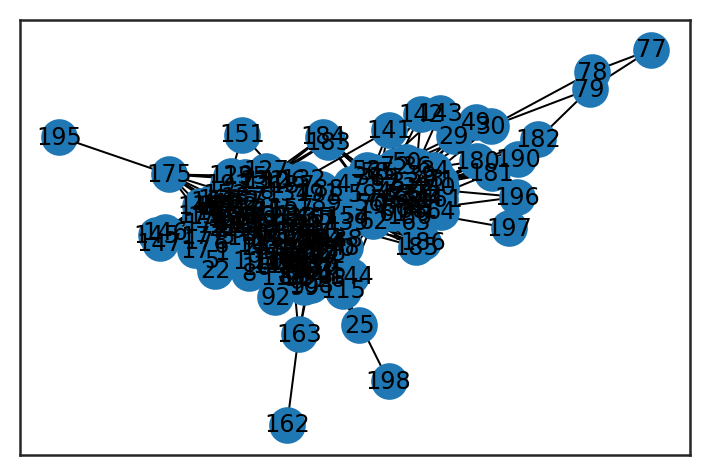

In [6]:
nx.draw_networkx(network)

No es una imagen atractiva, pero ya trabajaremos eso. ¿Cómo? Internamente, NX utiliza `matplotlib`, lo que significa que todo lo que hemos visto hasta ahora puede mezclarse con la visualización de redes.

Si queremos una visualización más grande podemos crear una figura de la siguiente manera:

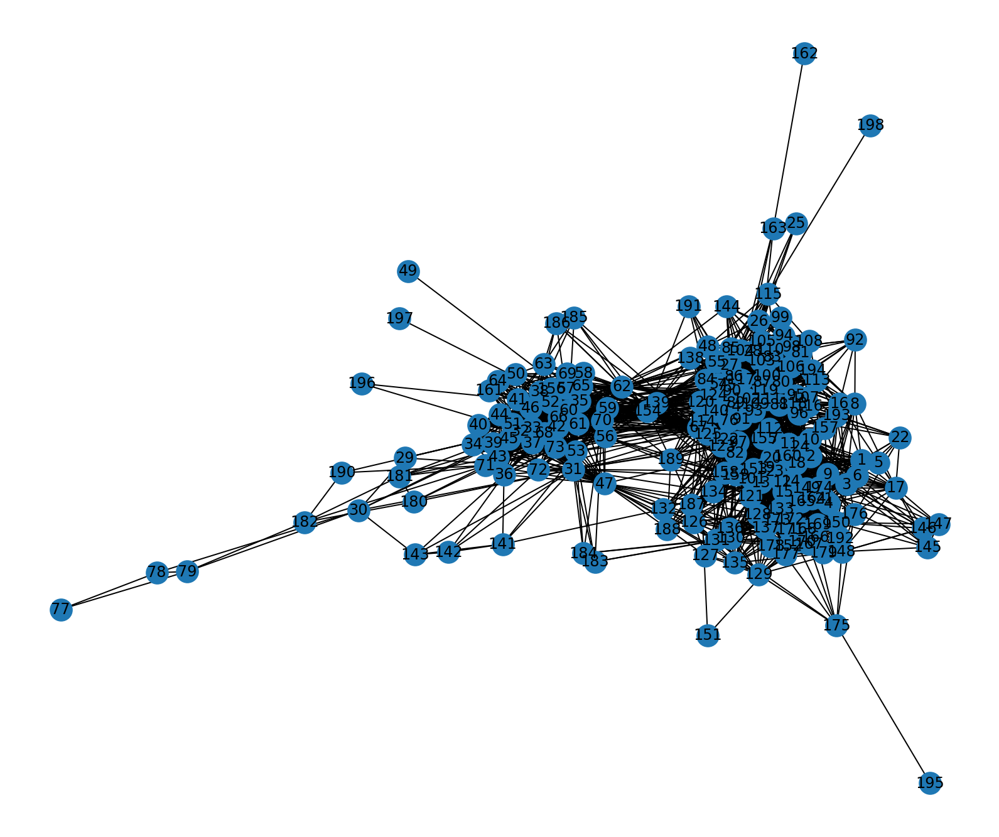

In [7]:
fig, ax = plt.subplots(1, 1, figsize=(14, 12))
nx.draw_networkx(network, ax=ax)
ax.set_axis_off()

Utilizamos métodos de `matplotlib` y la red se ve más grande y sin el _clutter_ del gráfico (como los bordes).

Sin embargo, **¿se dieron cuenta de algo?**

**¡La red no se visualiza de la misma manera cada vez que se ejecuta `draw_matplotlib`!

Pongamos atención a lo siguiente:

  1. Cuando cargamos la red, en ningún momento especificamos una posición `(x, y)` para cada nodo de la red.
  2. Al visualizar la red, esas posiciones tienen que salir de algún método.
  
El método que genera las posiciones es un _algoritmo de organización_ (_layout algorithm_). Estos algoritmos posicionan los nodos en la imagen, y algunos utilizan números aleatorios para encontrar buenas posiciones de los nodos. Al ser un proceso que se ejecuta cada vez que dibujamos la red, el resultado es distinto.

NX incluye varios tipos de algoritmo. Algunos de ellos son determinísticos, por ejemplo, la _organización circular_ es uno de ellos. Pone cada nodo dentro de un círculo, en el mismo orden en el que fueron agregados a la red. Se utiliza así:
In fact, NX includes several layouts. Some of them are deterministic, for instance, the _circular layout_ is one of them. It places each node in a circle, in the same order as nodes were added into the graph. It can be calculated with the `circular_layout` function. It looks like this:

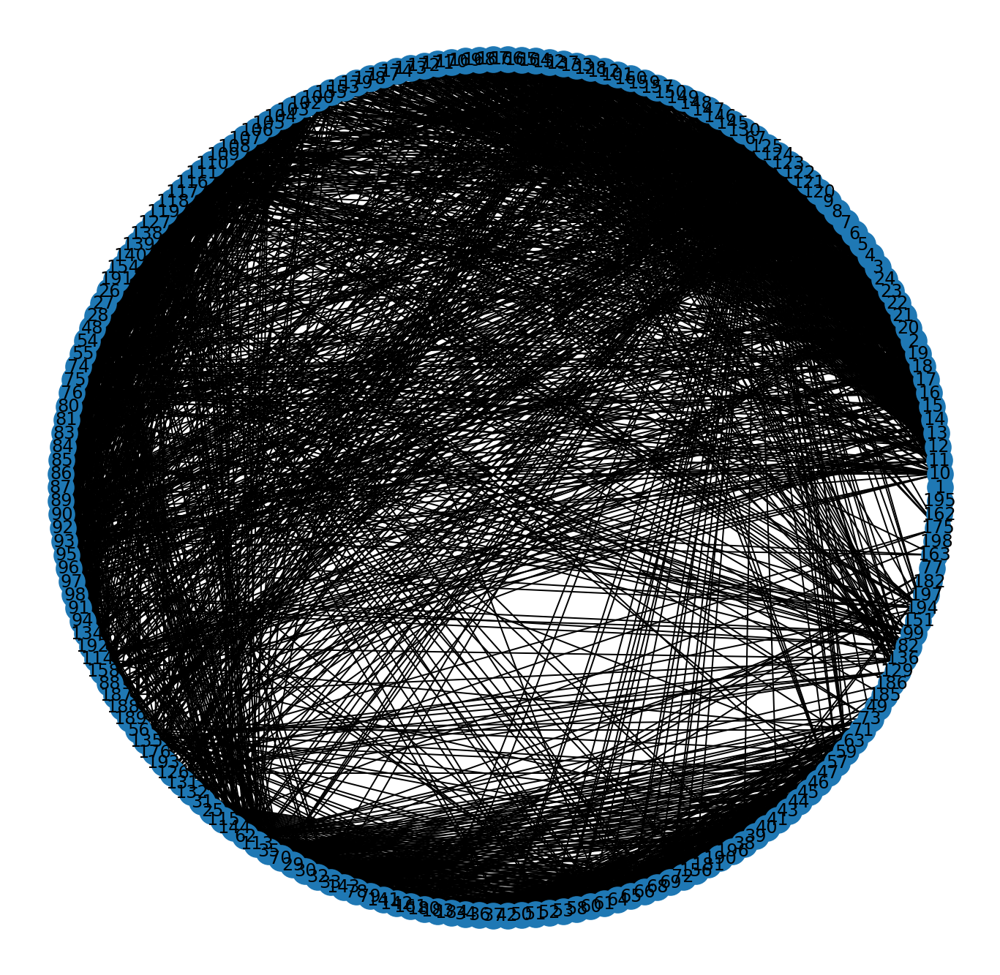

In [8]:
fig, ax = plt.subplots(1, 1, figsize=(12,12))
# el argumento pos recibe posiciones de nodos
nx.draw_networkx(network, ax=ax, pos=nx.layout.circular_layout(network))
ax.set_axis_off()

Aunque la organización es determinística, se ve muy mal. En general, la visualización por omisión en NX no tiene criterios estéticos, sino más bien funcionales. Como utiliza `matplotlib` podemos manipularla de muchas maneras que veremos hoy.

Por ahora, exploremos otra manera de organizar los nodos. Utilizaremos la biblioteca `pydot` que hace de puente con la herramienta de visualización de redes `graphviz`.
Entre las herramientas que incluye `graphviz` se encuentra el programa `twopi`, que produce organizaciones radiales:

In [9]:
positions = nx.drawing.nx_pydot.graphviz_layout(network, prog='twopi')

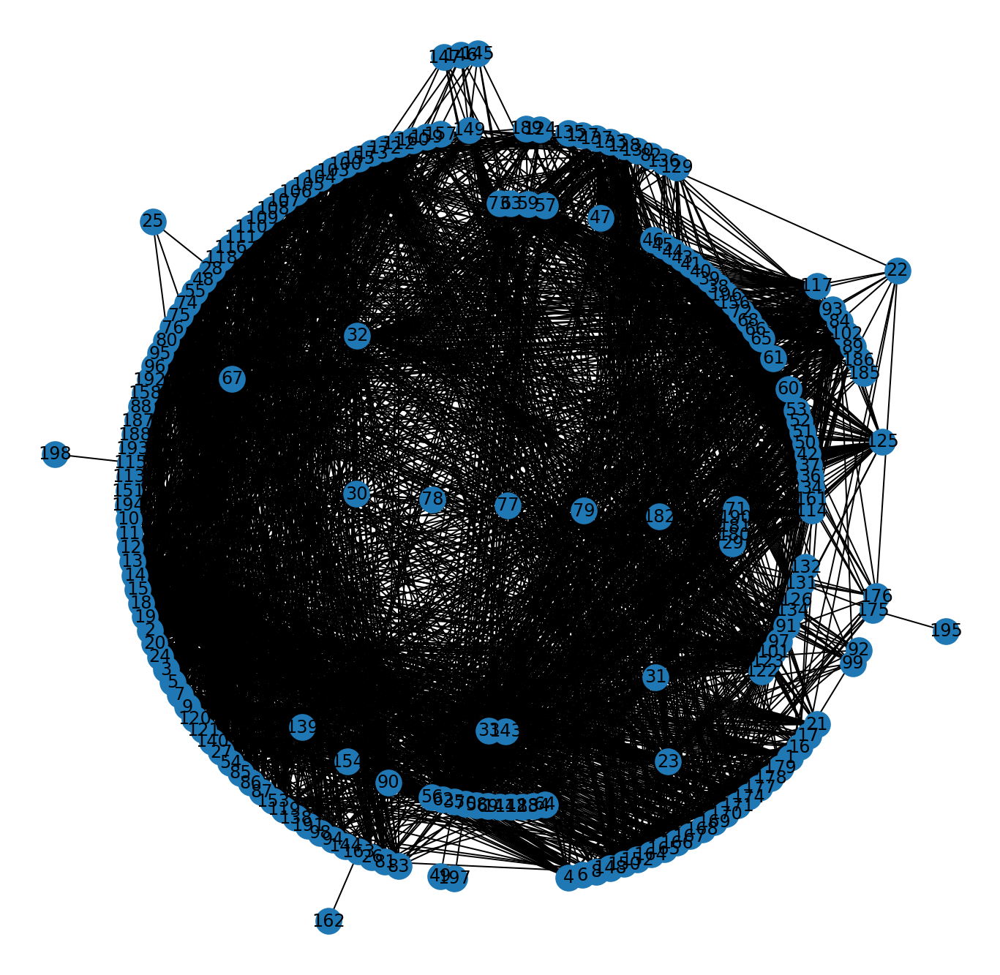

In [10]:
fig, ax = plt.subplots(1, 1, figsize=(12, 12))
nx.draw_networkx(network, ax=ax, pos=positions)
ax.set_axis_off()

Este tipo de organización puede ser interesante cuando hay estructuras de árboles en los datos. Sin embargo, como estamos trabajando con una red de colaboración, la estructura de la red tiene pocas probabilidades de ser jerárquica.

Otro programa en `graphviz` es `neato`:

In [11]:
positions = nx.drawing.nx_pydot.graphviz_layout(network, prog='neato')

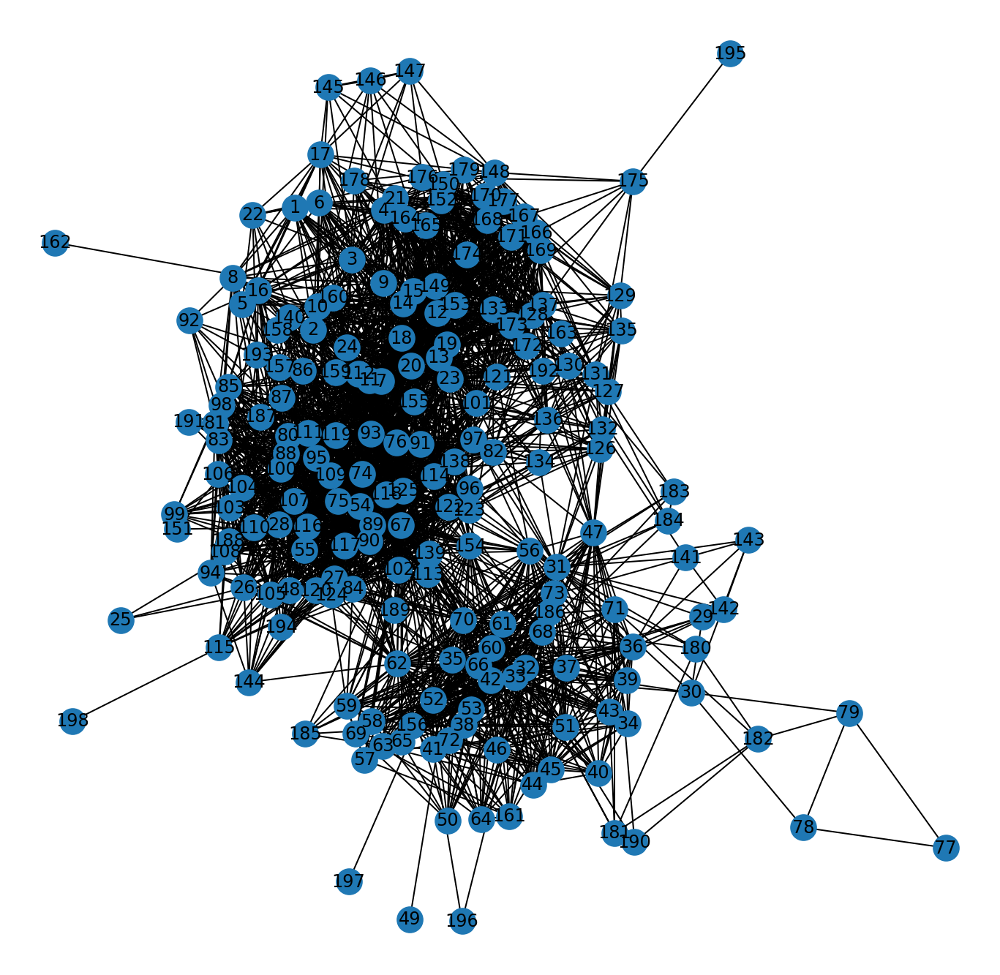

In [12]:
fig, ax = plt.subplots(1, 1, figsize=(12, 12))
nx.draw_networkx(network, ax=ax, pos=positions)
ax.set_axis_off()

Esta organización se ve interesante. Los nodos conectados entre sí aparecen más cerca, se observan claramente los nodos periféricos, y pareciera que hay dos grandes comunidades de artistas.

Usaremos esta organización en el resto del notebook. Ahora veamos tareas que se ejecutan con redes.

## Estimar y Visualizar Caminos en la Red

Una tarea común es visualizar los caminos en una red. Por ejemplo, cada vez que pides instrucciones o caminos en una aplicación de mapas, estás observando el resultado de una estimación de caminos en la red (usualmente el camino más corto, _shortest path_). La diferencia es que en los mapas el territorio define la organización.

En el caso de una red de colaboración, una posible interpretación de un camino más corto es la secuencia de personas a las que debes contactar para conocer a alguien específico.

Veamos como graficar caminos entre dos nodos aleatorios en la red.
Para ello, importaremos el módulo `random`:

In [13]:
import random
# el método nodes() es un iterador por los nodos de la red, que permite verlos como si fueran una lista.
random.sample(network.nodes(), 2)

[165, 180]

El método `shortest_path` de NX entrega la secuencia de nodos para ir desde un nodo origen hasta un nodo destino:parameters:

In [14]:
random_path = nx.shortest_path(network,  *random.sample(network.nodes, 2))
random_path

[32, 139, 20]

Para graficar el camino haremos lo siguiente:

- Ejecutaremos `draw_networkx` para la red completa.
- Ejecutaremos `draw_networkx` para el camino más corto.
- En ambos casos utilizaremos opciones de apariencia distintas.

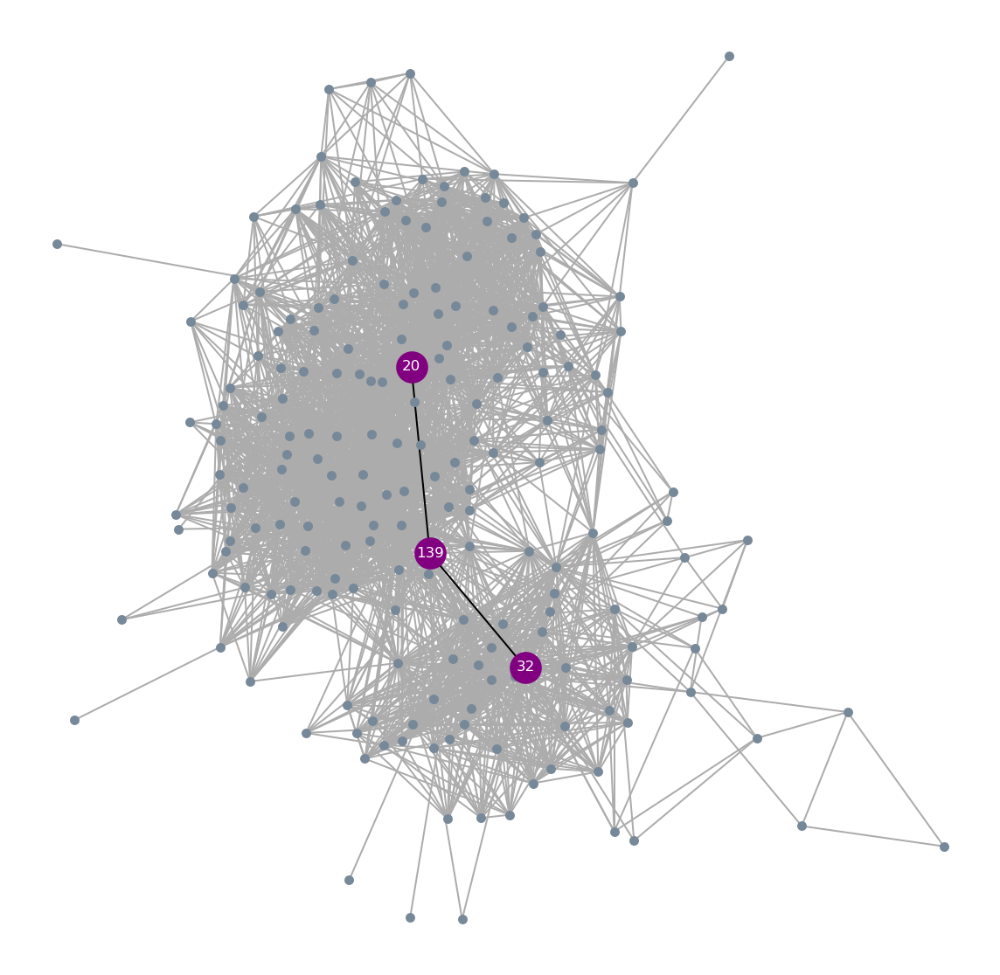

In [15]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

nx.draw_networkx(network, ax=ax, pos=positions, node_color='#778899',
                 edge_color='#abacab', with_labels=False, node_size=20)

nx.draw_networkx(nx.subgraph(network, random_path), ax=ax, pos=positions, node_color='purple', 
                 node_size=300, font_color='white', font_size='small')

ax.set_axis_off()

Como vemos, el camino es claramente visible. Tenemos una noción de dónde está cada uno de los nodos involucrados en la red, e incluso podemos ver que al parecer el camino cruza desde una comunidad a otra.

El código también mostró algunos de los atributos que recibe `draw_networkx`.

Ahora bien, debemos tener cuidado al ver una visualización como ésta: el algoritmo de organización tiene un criterio gráfico para posicionar nodos en la imagen, una comunidad o _cluster_ en la visualización no necesariamente representa un _cluster real en la estructura_.


## Tarea: Detección de Comunidades

Una tarea común en el análisis de redes es encontrar comunidades de nodos, es decir, grupos que estén altamente conectados entre sí en comparación con las conexiones de los demás nodos. A veces estamos interesados en el comportamiento colectivo de la red, y en ese caso, podríamos analizar los patrones de comportamiento de las comunidades en vez de los de cada nodo.

En nuestro data set, la visualización sugiere que hay al menos dos comunidades. Quizás hay más. No lo sabemos aún. Pero, ¿cuál es el significado de comunidad aquí? El data set es sobre músicos de jazz que interpretan música juntos. Entonces, quizás cada comunidad se refiere a estilos específicos de interpretación, a variaciones del jazz, a ubicaciones en las que tocan música, etc.

Usualmente cuando tenemos una red queremos _inferir_ sus comunidades. Una manera de hacerlo es utilizando el [Método de Louvain](https://es.wikipedia.org/wiki/M%C3%A9todo_de_Louvain). Está implementado en la biblioteca `community`, que se instala así: `pip install python-louvain`.

Para trabajar también utilizaremos métodos de la biblioteca auxiliar `cytoolz`, que facilitan trabajar con diccionarios. ¿Por qué? Porque la representación interna de una red en NX es un diccionario! :)

In [16]:
import community
from cytoolz import keymap, keyfilter, valmap, valfilter, itemmap, frequencies

En el módulo `community`, la función `generate_dendrogram` estima la partición en comunidades de la red. El resultado es un conjunto jerárquico de comunidades, que tiene varios niveles: es decir, primero particiona la red en comunidades grandes, que a su vez se pueden ir particionando en sub-comunidades. Lo común es quedarse con el nivel más específico, pero hoy usaremos todos los niveles más adelante.

Se ejectua así:

In [17]:
dendrogram = community.generate_dendrogram(network, random_state=42)

Para obtener la partición de comunidades más específica, le pedimos el último nivel al dendrograma utilizando la función `partition_at_level`:

In [18]:
communities = community.partition_at_level(dendrogram, len(dendrogram) - 1)

La variable `communities` es un diccionario con la siguiente estructura: `{node_id -> community_id}`. Se ve así:

In [19]:
# elegimos 5 nodos al azar
sample_keys = random.sample(communities.keys(), 5)
# mostramos el subdiccionario que tiene esos 5 nodos
keyfilter(lambda x: x in sample_keys, communities)

{74: 1, 95: 1, 158: 0, 35: 3, 60: 3}

Como vemos, cada comunidad tiene un número, que parte en 0.

Podemos estimar el tamaño de cada comunidad utilizando el método `frequencies` de `cytoolz`:

In [20]:
community_sizes = frequencies(communities.values())
print('# de Comunidades:', len(community_sizes))
community_sizes

# de Comunidades: 4


{0: 65, 1: 66, 2: 4, 3: 63}

Para visualizar las comunidades utilizaremos una paleta de colores. 

Si antes teníamos un diccionario `{node_id -> community_id}`, ahora necesitamos un diccionario `{node_id -> color de la comunidad community_id}`.

La biblioteca `seaborn` tiene un método llamado `color_palette` que genera listas de colores. Le pediremos una paleta apta para gente con ceguera de colores:

['#0173b2', '#de8f05', '#029e73', '#d55e00']


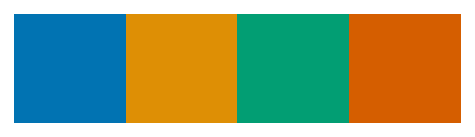

In [21]:
from matplotlib.colors import rgb2hex

palette = sns.color_palette('colorblind', n_colors=len(community_sizes))
# esto convierte cada color a una representación hexadecimal, como la usada en los Sitios Web
palette = list(map(rgb2hex, palette))
print(palette)
# este método grafica la paleta de colores
sns.palplot(palette)
plt.axis('off');

La variable `palette` es una lista y por tanto podemos acceder a sus colores utilizando el operador `[]`. Por ejemplo, `palette[0]` contiene el color de la comunidad 0.

Podemos crear el diccionario de colores utilizando la función `valmap` de `cytoolz`, que aplica una función a cada valor de elemento de un diccionario(_value map_), y guarda el resultado en un diccionario que tiene las mismas llaves. Se ve así:

In [22]:
# definimos una función lambda: palette[x] obtiene el color x de la paleta
node_colors = valmap(lambda x: palette[x], communities)
keyfilter(lambda x: x in sample_keys, node_colors)

{74: '#de8f05', 95: '#de8f05', 158: '#0173b2', 35: '#d55e00', 60: '#d55e00'}

Como vemos, ahora tenemos el mapa `{node_id -> color}`. 

Usemos esos colores para pintar la red:

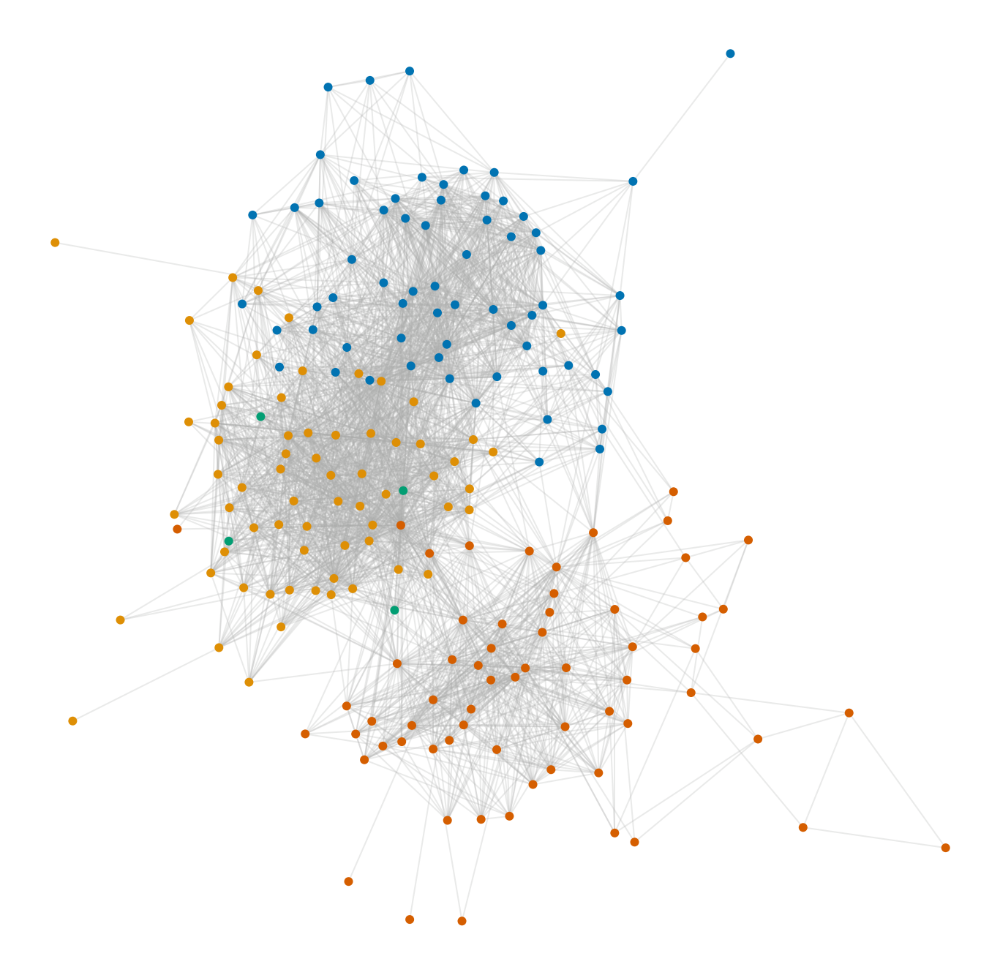

In [23]:
fig, ax = plt.subplots(1, 1, figsize=(12, 12))

nx.draw_networkx_edges(network, ax=ax, pos=positions, edge_color='#abacab', alpha=0.25, node_size=0)

nx.draw_networkx_nodes(network, ax=ax, pos=positions, 
                 # lamentablemente no podemos usar el diccionario directamente, así que recuperamos el color de cada nodo con este código
                 node_color=[node_colors[n] for n in network.nodes()],
                 node_size=25,
                 with_labels=False)

ax.set_axis_off()

¿Mejor, no? El algoritmo dice que hay cuatro comunidades, y al visualizarlas, observamos que hay una de ellas que se separa totalmente del resto, mientras que las otras tres parecen estar un poco mezcladas. Hay una que es tan pequeña que parece ser un grupo exclusivo de cuatro personas.

Hay maneras de evaluar si esta partición es adecuada, pero no es el foco de este taller. Estamos interesados en visualizar estas comunidades de manera que podamos observar como se relacionan unas con otras.

El siguiente paso es darle color a las aristas de acuerdo a las comunidades de sus nodos miembro. Lo podemos hacer de la siguiente manera:

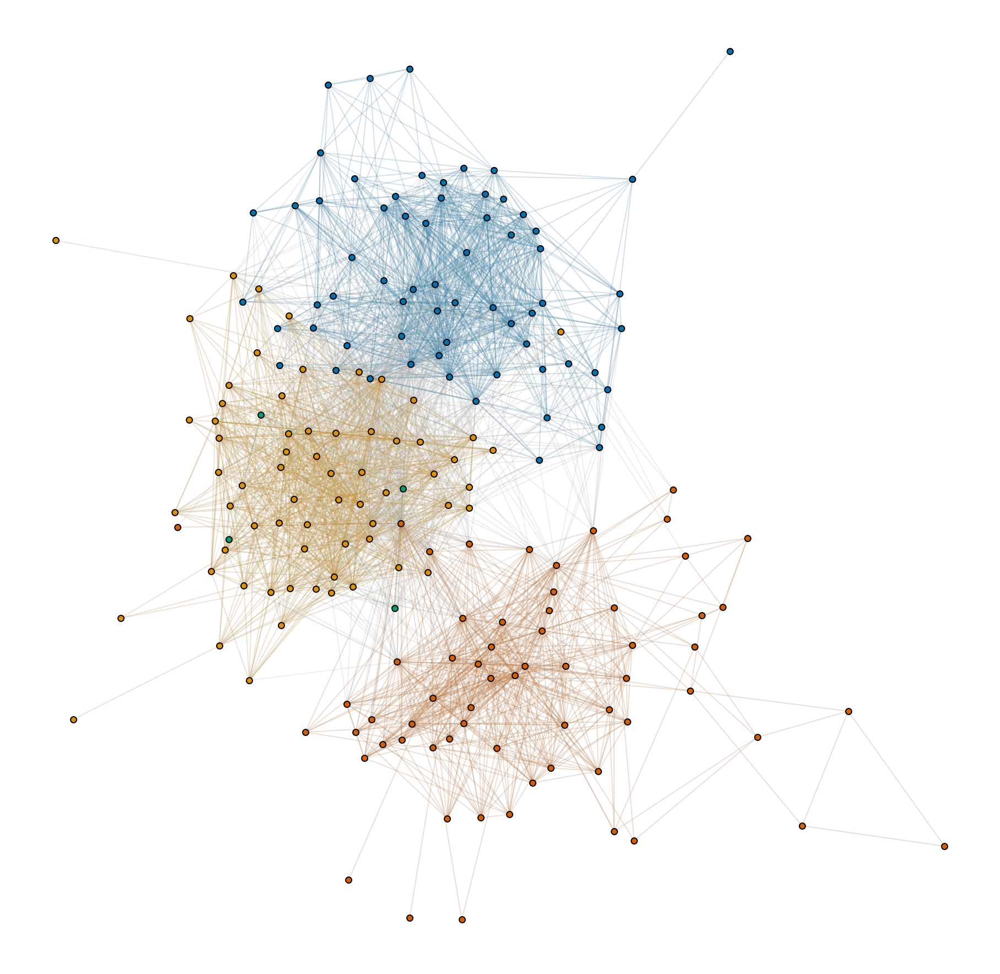

In [24]:
fig, ax = plt.subplots(1, 1, figsize=(16,16))

# dibujamos todas las aristas con el mismo color, un gris.
# la función recibe un parámetro node_size. si es mayor a 0, las aristas no se tocan entre sí.
nx.draw_networkx_edges(network, ax=ax, pos=positions, edge_color='#abacab', node_size=0, alpha=0.2)

# por cada comunidad (y su respectivo color) dibujaremos los nodos y aristas correspondientes.
for community_id, color in enumerate(palette, start=0):
    # con esto encontramos los nodos de esta comunidad
    # valfilter: filtro de valores. deja solamente los elementos del diccionario que cumplan el filtro
    # y nos interesan las llaves del diccionario, es decir, los nodos.
    community_nodes = valfilter(lambda x: x == community_id, communities).keys()
    # este método nos entrega la sub-red determinada por los nodos de la comunidad
    community_graph = nx.subgraph(network, community_nodes)

    # dibujamos la sub-red con sus colores correspondientes
    nx.draw_networkx_edges(community_graph, ax=ax, pos=positions, edge_color=color, node_size=0, alpha=0.1)
    # nota: aquí el parámetro "edgecolors" se refiere al borde de los nodos, no a las "edges" (aristas) de la red.
    # la confusión se debe a que matplotlib llama "edgecolor" al parámetro que configura el borde de los puntos
    # a fin de cuentas, lo que hace NX es dibujar un scatterplot!
    nx.draw_networkx_nodes(community_graph, ax=ax, pos=positions, node_color=color, edgecolors='black', linewidths=1, node_size=30, with_labels=False)

ax.set_axis_off()

¡Se ve bien!

Pero no estamos contentos aún.

Algunas comunidades se ven tan conectadas entre sí que es difícil observar su estructura interna.

Esta organización no nos permite resolver eso.

¿Recuerdan la organización circular? Quizás podemos  retomarla. Aprovecharemos que tenemos un color para cada nodo.

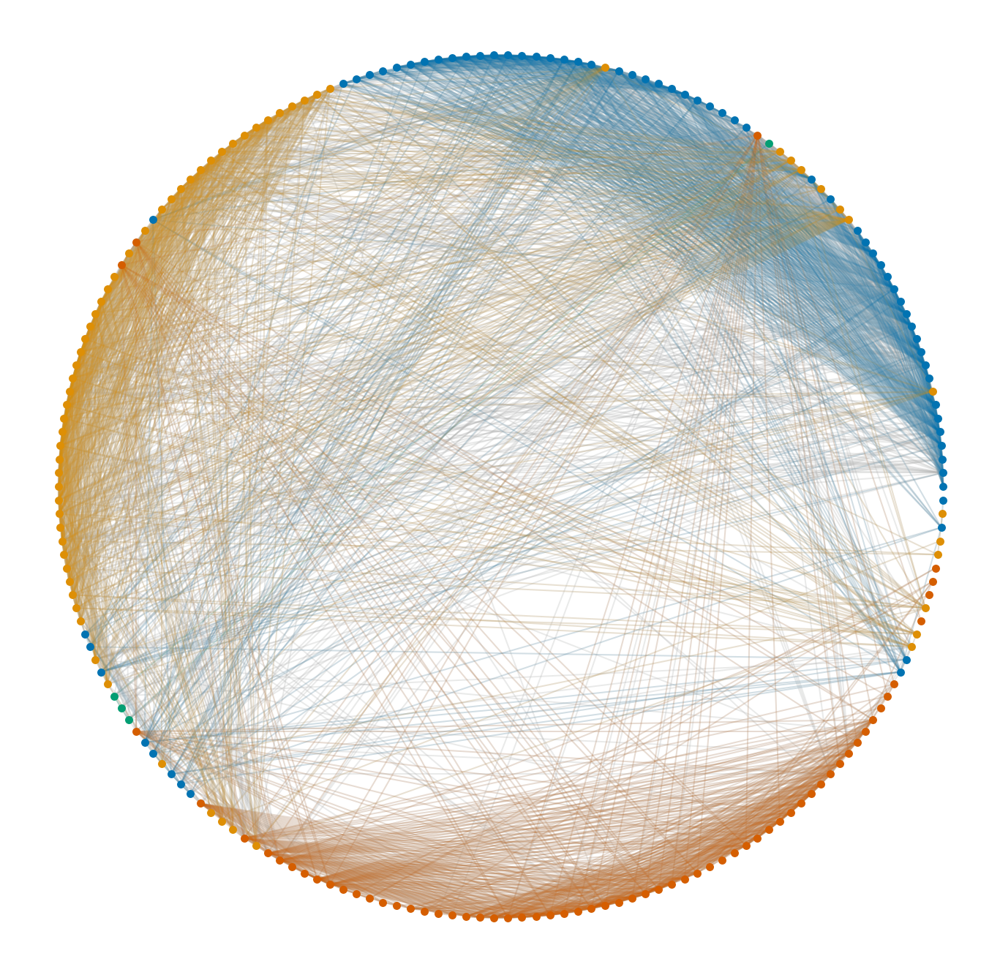

In [25]:
# nota: el código es el mismo de antes, solamente cambiamos la posición de los nodos
pos = nx.layout.circular_layout(network)

fig, ax = plt.subplots(1, 1, figsize=(12,12))

nx.draw_networkx_edges(network, pos=pos, edge_color='#abacab', node_size=0, alpha=0.25)

for community_id, color in enumerate(palette, start=0):
    community_nodes = valfilter(lambda x: x == community_id, communities).keys()
    community_graph = nx.subgraph(network, community_nodes)

    nx.draw_networkx_edges(community_graph, pos=pos, edge_color=color, node_size=0, alpha=0.1)
    nx.draw_networkx_nodes(community_graph, pos=pos, node_color=color, node_size=20, with_labels=False)

plt.axis('off');

Se ve mejor que antes. Pareciera que aquí tenemos una manera prometedora de estudiar como las comunidades se relacionan entre sí.

Hay dos sub-tareas que necesitamos resolver para mejorar nuestro análisis:

  1. Reordenar los nodos de acuerdo a la comunidad a la que pertenecen.
  2. Encontrar una manera de organizar las aristas de modo que no formen una "bola de pelos".
  
Hay una técnica de visualización que resuelve el problema. Se llama [**Hierarchical Edge Bundling**](https://bl.ocks.org/mbostock/1044242).

Ahora bien, como dice su nombre, HEB requiere una _jerarquía_ de nodos. Esta red no tiene una jerarquía. ¿Cómo podríamos usarla?

Resulta que sí hemos estimado una jerarquía. Es la jerarquía de comunidades que calculamos con el método de Louvain. Entonces, ¡implementemos HEB!

## Hierarchical Edge Bundling

Necesitamos convertir nuestra estructura de comunidades en un árbol. Este código lo hace. Por ahora considerémoslo como _magia negra_, ya que requiere entender la estructura de datos del dendrograma, y no es el propósito de esta clase.

Este código hace lo siguiente:

- Genera la jerarquía agregando los nodos originales de la red como _hojas de un árbol_.
- Cada nivel del árbol hacia arriba es el set de comunidades inferidas con el método de Louvain.

In [26]:
community_structure = nx.DiGraph()

node_from_h = {}

dst_to_node = None

for level, comms in enumerate(dendrogram, start=0):
    if dst_to_node is None:
        src_to_node = {}
    else:
        src_to_node = dst_to_node
        
    dst_to_node = {}
    
    for src, dst in comms.items():
        if not src in src_to_node:
            src_node_id = community_structure.number_of_nodes()
            community_structure.add_node(src_node_id)
            src_to_node[src] = src_node_id
            
            node_from_h[src_node_id] = src
            
        if not dst in dst_to_node:
            dst_node_id = community_structure.number_of_nodes()
            community_structure.add_node(dst_node_id)
            dst_to_node[dst] = dst_node_id
            
        community_structure.add_edge(dst_to_node[dst], src_to_node[src])
        
root_node_id = community_structure.number_of_nodes()
community_structure.add_node(root_node_id)

for src, dst in dendrogram[-1].items():
    community_structure.add_edge(root_node_id, dst_to_node[dst])
    
community_structure.number_of_nodes(), community_structure.number_of_edges()

(209, 208)

Hemos almacenado el resultado en una red de NX. Un árbol también es una red. La diferencia es que tiene jerarquía partiendo desde un nodo raíz.

El método `is_tree` de NX nos permite probar si una red es un árbol:

In [27]:
print('¿Es árbol la estructura de comunidades?', nx.is_tree(community_structure))
print('¿Es árbol la red de músicos?', nx.is_tree(network))

¿Es árbol la estructura de comunidades? True
¿Es árbol la red de músicos? False


Organizaremos los nodos de la comunidad con `twopi` de `graphviz`:

In [28]:
hierarchical_pos = nx.drawing.nx_pydot.graphviz_layout(community_structure, prog='twopi', root=root_node_id)

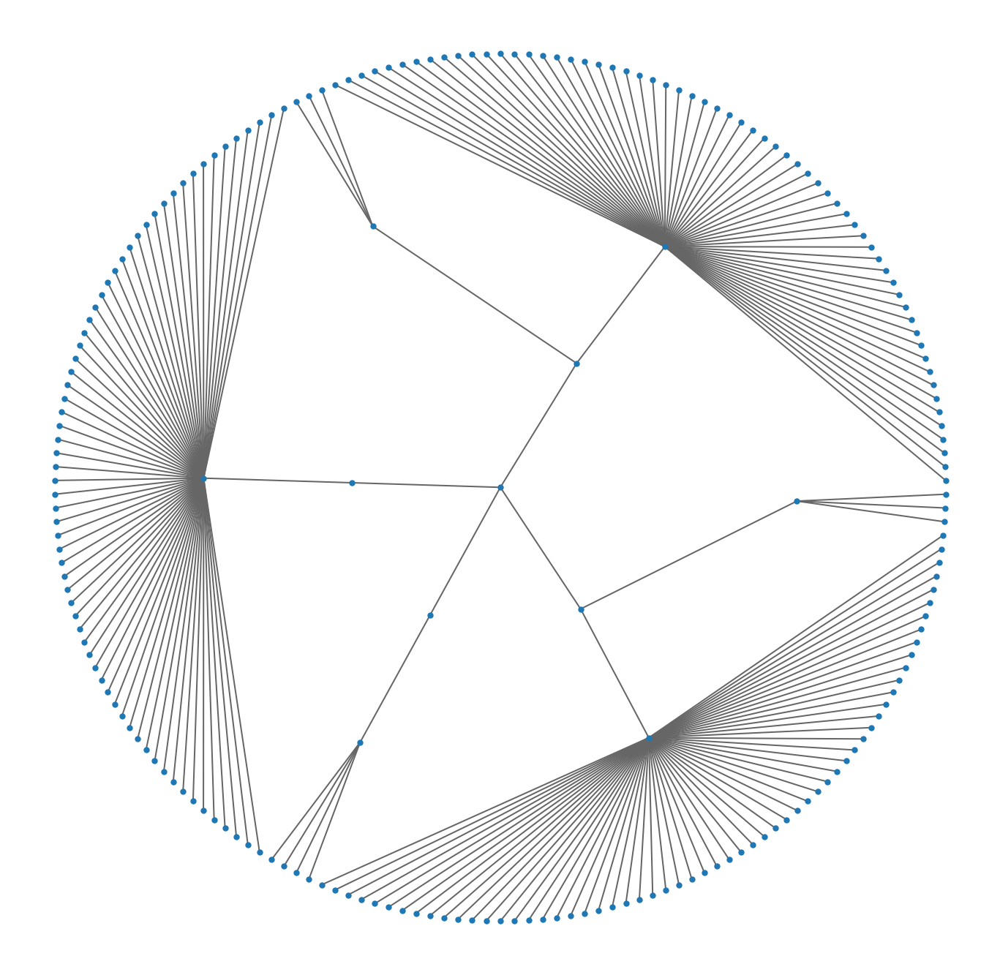

In [29]:
fig, ax = plt.subplots(1, 1, figsize=(12, 12))
nx.draw_networkx(community_structure, with_labels=False, ax=ax, node_size=10, pos=hierarchical_pos, 
                 arrows=False, edge_color='#666666')
ax.set_axis_off()

Los nodos que están en los bordes del círculo son los músicos, y los nodos interiores son las comunidades.

Noten como los nodos están ordenados de acuerdo a las comunidades. El nodo central es una raíz artificial que agregamos en nuestra magia negra, que nos permitió darle la estructura de árbol a la red total.

El siguiente paso es generar el diccionario de posiciones solamente para los nodos de nuestra red original:

In [30]:
circular_positions = keyfilter(lambda x: x in node_from_h, hierarchical_pos)
circular_positions = keymap(lambda x: node_from_h[x], circular_positions)
print(len(circular_positions), network.number_of_nodes())

198 198


In [31]:
keyfilter(lambda x: x in sample_keys, circular_positions)

{74: (27.0, 237.43),
 95: (46.492, 144.27),
 158: (215.63, 448.26),
 35: (195.39, 23.307),
 60: (341.95, 42.012)}

Veamos una comparación entre el gráfico circular que podemos hacer con estas nuevas posiciones:

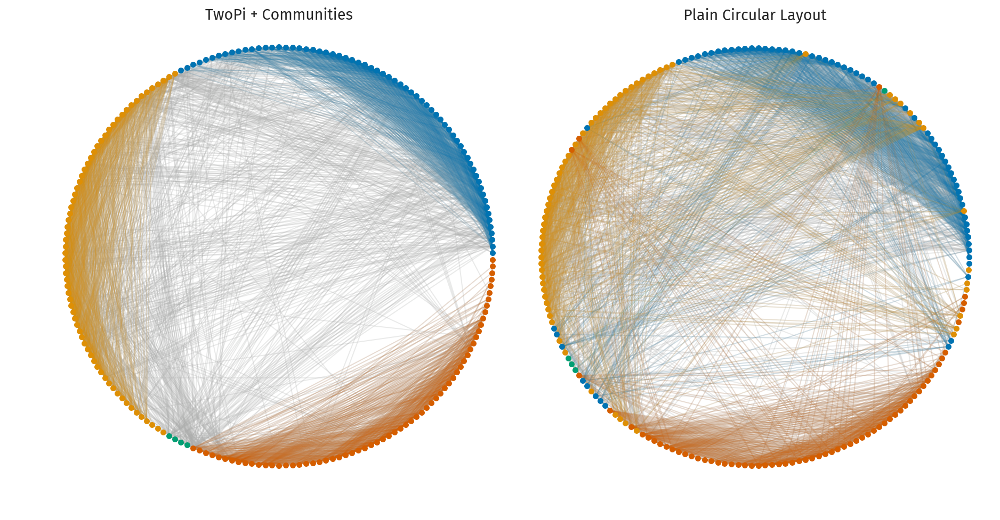

In [32]:
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

# usando comunidades y twopi
nx.draw_networkx_edges(network, pos=circular_positions, edge_color='#abacab', node_size=0, alpha=0.25, ax=axes[0])

for community_id, color in enumerate(palette, start=0):
    community_nodes = valfilter(lambda x: x == community_id, communities).keys()
    community_graph = nx.subgraph(network, community_nodes)
    nx.draw_networkx_edges(community_graph, pos=circular_positions, edge_color=rgb2hex(color), node_size=0, alpha=0.1, ax=axes[0])
    nx.draw_networkx_nodes(community_graph, pos=circular_positions, node_color=rgb2hex(color), node_size=20, with_labels=False, ax=axes[0])

axes[0].set_axis_off()
axes[0].set_title('TwoPi + Communities')

# usando la configuración original de los nodos
circular_layout_positions = nx.circular_layout(network)

nx.draw_networkx_edges(network, pos=circular_layout_positions, edge_color='#abacab', node_size=0, alpha=0.25, ax=axes[1])

for community_id, color in enumerate(palette, start=0):
    community_nodes = valfilter(lambda x: x == community_id, communities).keys()
    community_graph = nx.subgraph(network, community_nodes)
    nx.draw_networkx_edges(community_graph, pos=circular_layout_positions, edge_color=rgb2hex(color), node_size=0, alpha=0.1, ax=axes[1])
    nx.draw_networkx_nodes(community_graph, pos=circular_layout_positions, node_color=rgb2hex(color), node_size=20, with_labels=False, ax=axes[1])

axes[1].set_axis_off()
axes[1].set_title('Plain Circular Layout')

plt.subplots_adjust(wspace=0, hspace=0);

El resultado es mejor. Visualmente, podemos ver qué tan densa es la estructura de conexiones de cada comunidad, y también tener una noción de su tamaño.

Pero todavía hay trabajo por hacer. Porque las aristas siguen obstruyéndose entre sí. Menos que antes, pero el problema sigue.

En HEB, la estructura de comunidades se puede utilizar para dibujar aristas entre nodos. 

En vez de conectar directamente un nodo con otro con una línea recta, se utiliza una curva que recorre el camino entre dos nodos en la estructura radial de comunidades.
Un camino corto que se puede calcular con `shortest_path`, como hicimos antes.

Lo que nos hace falta es una manera de dibujar curvas suaves. En computación gráfica, dichas curvas se conocen como _Bèzier_ o _B-Splines_. Afortunadamente, en Python podemos calcular estas curvas utilizando la biblioteca `scipy`:

(**Aviso: más magia negra**)

In [33]:
# source: https://stackoverflow.com/questions/34803197/fast-b-spline-algorithm-with-numpy-scipy
import scipy.interpolate as si
import numpy as np

def scipy_bspline(cv, n=100, degree=3, periodic=False):
    """ Calculate n samples on a bspline

        cv :      Array ov control vertices
        n  :      Number of samples to return
        degree:   Curve degree
        periodic: True - Curve is closed
    """
    cv = np.asarray(cv)
    count = cv.shape[0]

    # Closed curve
    if periodic:
        kv = np.arange(-degree,count+degree+1)
        factor, fraction = divmod(count+degree+1, count)
        cv = np.roll(np.concatenate((cv,) * factor + (cv[:fraction],)),-1,axis=0)
        degree = np.clip(degree,1,degree)

    # Opened curve
    else:
        degree = np.clip(degree,1,count-1)
        kv = np.clip(np.arange(count+degree+1)-degree,0,count-degree)

    # Return samples
    max_param = count - (degree * (1-periodic))
    spl = si.BSpline(kv, cv, degree)
    return spl(np.linspace(0,max_param,n))

In [34]:
node_to_h = itemmap(reversed, node_from_h)
community_structure_undirected = community_structure.to_undirected()

def edge_to_spline(src, dst, n_points=100, smoothing_factor=0.8):
    edge_path = nx.shortest_path(community_structure_undirected, node_to_h[src], node_to_h[dst])
    edge_cp = [hierarchical_pos[node_id] for node_id in edge_path]
    
    try:    
        smooth_edge = scipy_bspline(edge_cp, degree=min(len(edge_cp) - 1, 3), n=n_points)
        source_edge = np.vstack((np.linspace(edge_cp[0][0], edge_cp[-1][0], num=n_points, endpoint=True),
                                 np.linspace(edge_cp[0][1], edge_cp[-1][1], num=n_points, endpoint=True))).T
        
        if smoothing_factor < 1.0:
            smooth_edge = smooth_edge * smoothing_factor + source_edge * (1.0 - smoothing_factor)
        
        return smooth_edge
    except ValueError:
        print(src, dst, 'error')
        return None

Si dibujásemos una arista al azar, se graficaría así:

In [35]:
# calculemos una arista al azar
random_nodes = random.sample(network.nodes(), 2)

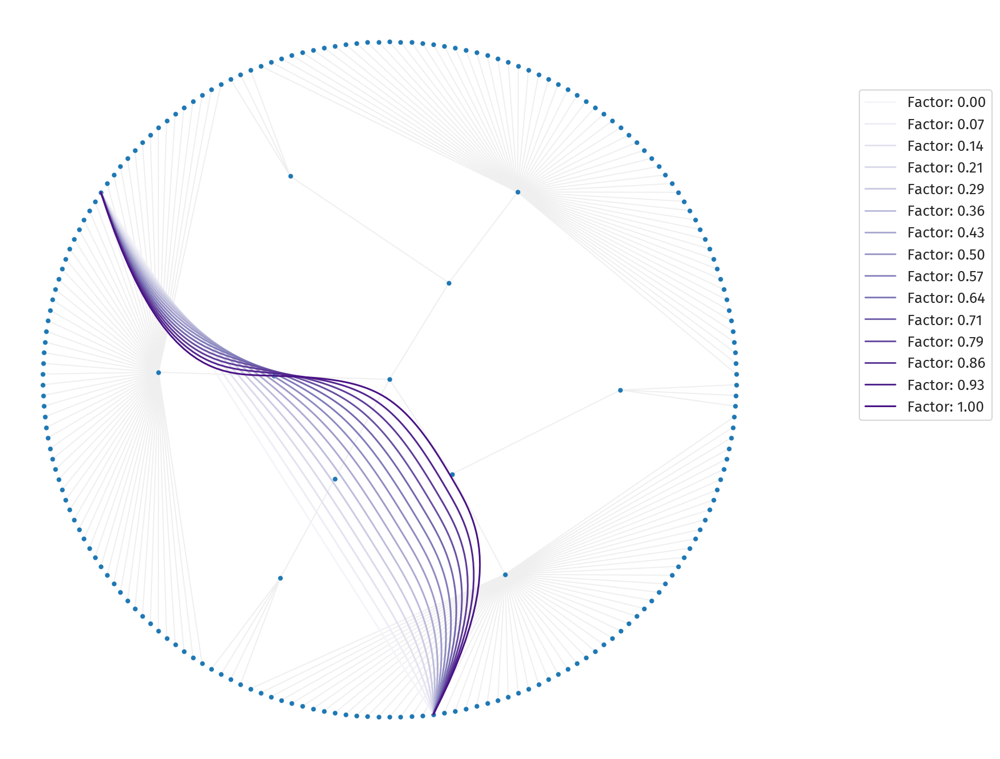

In [36]:
# dibujemos la red de comunidades para ver su relación con la arista
fig, ax = plt.subplots(1, 1, figsize=(12, 12))
nx.draw_networkx(community_structure, with_labels=False, ax=ax, node_size=10, pos=hierarchical_pos, 
                 arrows=False, edge_color='#efefef')

# graficaremos varios factores de suavizamiento para ver como se comporta el algoritmo
smoothing_factors = np.linspace(0, 1, 15)
purples = sns.color_palette('Purples', n_colors=len(smoothing_factors))

for color, factor in zip(purples, smoothing_factors): 
    # calculamos la arista
    test_edge = edge_to_spline(*random_nodes, smoothing_factor=factor)
    # la dibujamos con matplotlib
    ax.plot(test_edge[:,0], test_edge[:,1], color=color, label='Factor: {:.2f}'.format(factor))
    
ax.legend(bbox_to_anchor=(1.0, 0.4, 0.3, 0.5))
ax.set_axis_off();

El factor de suavizamiento (`smoothing_factor`) nos permite controlar si queremos que la arista se dibuje como una línea recta (0) o como una curva _B-Spline_ controlada totalmente por la jerarquía de comunidades (1). Un valor intermedio realiza una interpolación entre ambos extremos. Esta modulación permitirá definir qué tan concentradas queremos que estén las aristas.

Digamos que elegimos un factor de `0.75`. Calculemos todas las aristas de una vez:

In [37]:
edge_lines = []
smoothing_factor = 0.75
# resolución de cada arista en vértices. más puntos, mejor calidad de imagen, pero más tiempo de cálculo y de dibujo.
n_points = 50

for src, dst in network.edges():    
    edge_lines.append(edge_to_spline(src, dst, n_points=n_points, smoothing_factor=smoothing_factor))

Esta vez tendremos que usar nuestro propio método de dibujo, directamente con `matplotlib`.
Así que haremos una lista de colores para las aristas:

In [38]:
edge_colors = []

for src, dst in network.edges():
    if communities[src] == communities[dst]:
        edge_colors.append(node_colors[src])
    else:
        edge_colors.append('grey')

¡Con esto ya tenemos todo lo necesario para hacer nuestra primera visualización HEB!

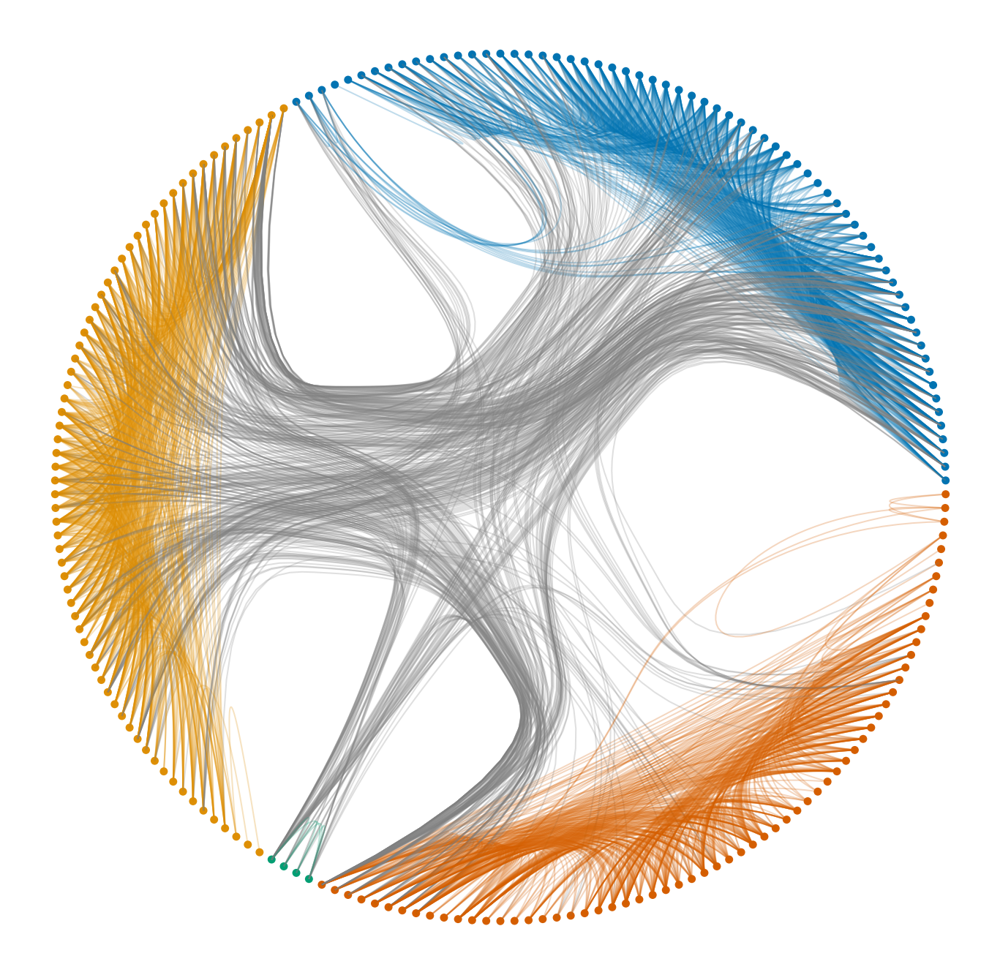

In [39]:
from matplotlib.collections import LineCollection

fig, ax = plt.subplots(1, 1, figsize=(12, 12))

# dibujamos los nodos en sus posiciones
nx.draw_networkx_nodes(network, ax=ax, pos=circular_positions, 
                 node_color=[node_colors[n] for n in network.nodes],
                 node_size=20,
                 with_labels=False)

# dibujamos las aristas que hemos calculado
edge_collection = LineCollection(edge_lines, color=edge_colors, linewidth=1, linestyle='solid', alpha=0.25)
ax.add_collection(edge_collection)

ax.set_axis_off()

Increíble, ¿no? Ahora podemos ver como las comunidades se conectan entre sí y también como los miembros de una comunidad se relacionan. Vemos quienes son populares y quienes son puentes con otras comunidades. Piensen en lo útil que podría ser esto para un agente artístico.

Podemos comparar las visualizaciones que hemos hecho para saber cuánto hemos aprendido hoy:

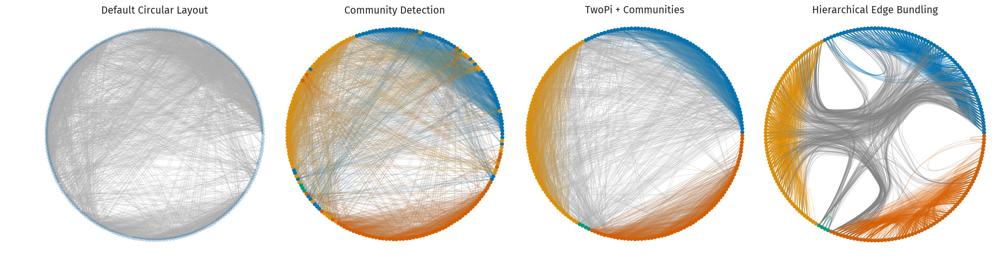

In [40]:
fig, axes = plt.subplots(1, 4, figsize=(24, 6))

# circular layout with networkx
circular_layout_positions = nx.circular_layout(network)

# default

nx.draw_networkx(network, pos=nx.layout.circular_layout(network), edge_color='#abacab', node_size=20, alpha=0.25, with_labels=False, ax=axes[0])
axes[0].set_axis_off()
axes[0].set_title('Default Circular Layout')


nx.draw_networkx_edges(network, pos=circular_layout_positions, edge_color='#abacab', node_size=0, alpha=0.25, ax=axes[1])

for community_id, color in enumerate(palette, start=0):
    community_nodes = valfilter(lambda x: x == community_id, communities).keys()
    community_graph = nx.subgraph(network, community_nodes)
    nx.draw_networkx_edges(community_graph, pos=circular_layout_positions, edge_color=rgb2hex(color), node_size=0, alpha=0.1, ax=axes[1])
    nx.draw_networkx_nodes(community_graph, pos=circular_layout_positions, node_color=rgb2hex(color), node_size=20, with_labels=False, ax=axes[1])

axes[1].set_axis_off()
axes[1].set_title('Community Detection')

# layout using communities
nx.draw_networkx_edges(network, pos=circular_positions, edge_color='#abacab', node_size=0, alpha=0.25, ax=axes[2])

for community_id, color in enumerate(palette, start=0):
    community_nodes = valfilter(lambda x: x == community_id, communities).keys()
    community_graph = nx.subgraph(network, community_nodes)
    nx.draw_networkx_edges(community_graph, pos=circular_positions, edge_color=rgb2hex(color), node_size=0, alpha=0.1, ax=axes[2])
    nx.draw_networkx_nodes(community_graph, pos=circular_positions, node_color=rgb2hex(color), node_size=20, with_labels=False, ax=axes[2])

axes[2].set_axis_off()
axes[2].set_title('TwoPi + Communities')


# HEB
nx.draw_networkx_nodes(network, pos=circular_positions, 
                 node_color=[node_colors[n] for n in network.nodes],
                 node_size=20,
                 with_labels=False, ax=axes[3])

edge_collection = LineCollection(edge_lines, color=edge_colors, linewidth=0.8, linestyle='solid', alpha=0.25)
axes[3].add_collection(edge_collection)
axes[3].set_axis_off()
axes[3].set_title('Hierarchical Edge Bundling')

plt.subplots_adjust(wspace=0, hspace=0);

Aún nos falta algo.

¿Qué pasa si queremos saber quién es quién en la visualización? Después de todo, las personas tienen nombres, y eso permitiría resolver más tareas con la visualización.

Este data set no contiene nombres, pero podemos asignar una etiqueta a cada persona de la red, y mostrar como se grafican las etiquetas. Para ello tendrán que desempolvar sus conocimientos de trigonometría, porque tendremos que calcular ángulos y distancias :)

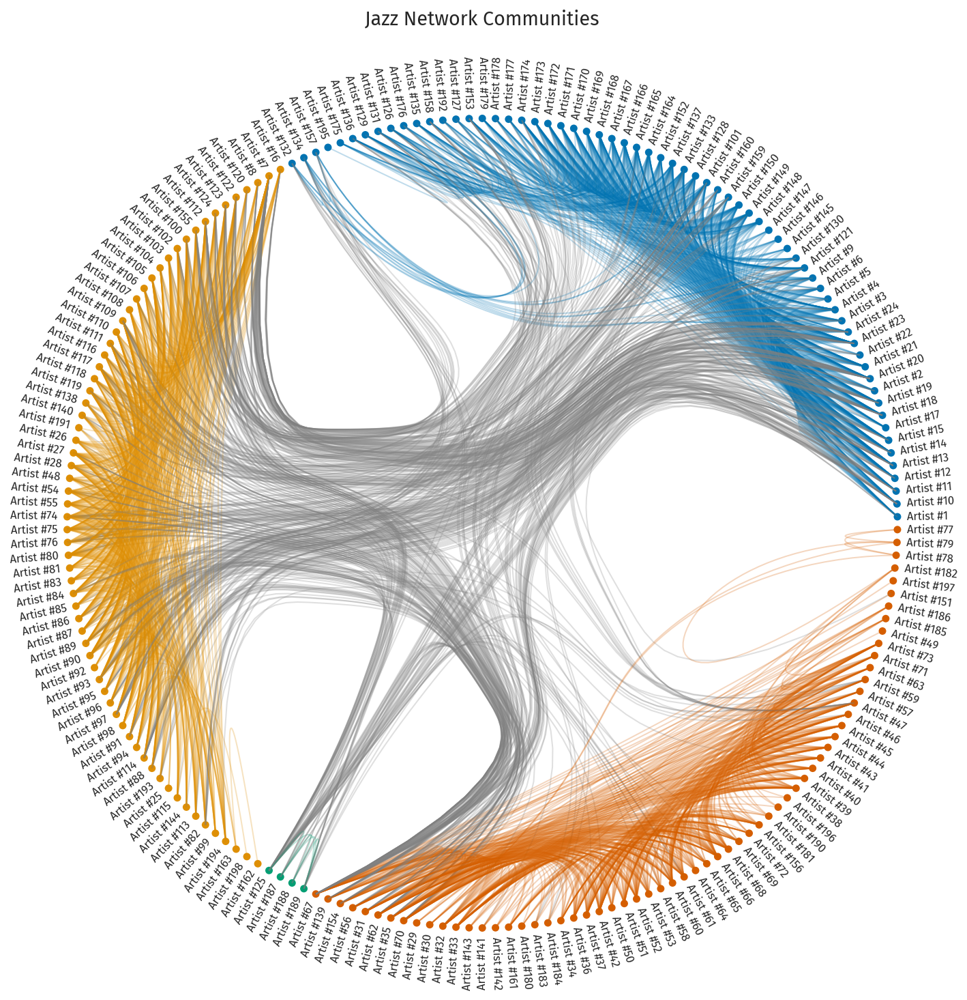

In [41]:
fig, ax = plt.subplots(1, 1, figsize=(12, 12))

# aquí dibujamos la red con HEB
nx.draw_networkx_nodes(network, ax=ax, pos=circular_positions, 
                 node_color=[node_colors[n] for n in network.nodes],
                 node_size=20,
                 with_labels=False)

edge_collection = LineCollection(edge_lines, color=edge_colors, linewidth=1, linestyle='solid', alpha=0.25)
plt.gca().add_collection(edge_collection)

# ahora agregaremos los nombres de las personas
# necesitamos orientarlas respecto al centroide de la visualización
centroid = np.mean(list(circular_positions.values()), axis=0)

# para cada nodo calcularemos la posición y el ángulo de su etiqueta
for node_id, pos in circular_positions.items():
    # posición del nodo
    pos = np.array(pos)
    # vector desde el centro hasta el nodo
    vec = pos - centroid
    # distancia desde el centro en la que aparecerá la etiqueta, con un espacio extra en blanco
    length = np.sqrt(vec.dot(vec)) + 5
    # vector unitario en dirección del texto
    vec = vec / length
    # ángulo determinado por el vector
    angle = np.arctan2(vec[1], vec[0])
    
    # ¿cómo orientaremos el texto? 
    va = 'center'
    
    if vec[0] >= 0:
        ha = 'left'
    else:
        ha = 'right'
    
    text_rotation = np.rad2deg(angle)
    
    if text_rotation > 90:
        text_rotation = text_rotation - 180
    elif text_rotation < -90:
        text_rotation = text_rotation + 180
        
    # con esto agregamos el texto a la visualización
    plt.annotate('Artist #{}'.format(node_id), 
                 (centroid[0] + length * np.cos(angle), centroid[1] + length * np.sin(angle)), 
                 rotation=text_rotation, ha=ha, va=va, rotation_mode='anchor',
                 fontsize='small')
    
ax.set_title('Jazz Network Communities', y=1.05)
ax.set_axis_off()

Con esto terminamos esta clase.

La visualización de redes permite estudiar los datos a traves de las relaciones presentes en ellos, lo que la vuelve un buen complemento para las otras técnicas que hemos trabajado en el curso.